## 📌 Concrete Compressive Strength — Project Overview

## 🧩 Problem Statement

The purpose of this project is to build a **Decision Tree Regressor** that can predict the **compressive strength of concrete** based on its material composition.
This prediction helps in construction quality control, civil engineering decisions, and optimizing concrete mixtures.

---

## 📊 Dataset Information

## 🏷️ Dataset Name

Concrete Compressive Strength Dataset

## 🌐 Source

UCI Machine Learning Repository

## 🔗 URL

[https://archive.ics.uci.edu/ml/machine-learning-databases/concrete/compressive/Concrete_Data.xls](https://archive.ics.uci.edu/ml/machine-learning-databases/concrete/compressive/Concrete_Data.xls)

---

## 📐 Dataset Shape

* **Total Rows:** 1,030
* **Total Columns:** 9

---

## 🧬 Dataset Columns

* **Cement** (component — kg/m³)
* **Blast Furnace Slag**
* **Fly Ash**
* **Water**
* **Superplasticizer**
* **Coarse Aggregate**
* **Fine Aggregate**
* **Age** (days)
* **Concrete Compressive Strength** (MPa) → **Target**

---

## 🎯 Features and Target Used in This Project

## 🔹 Features (X) — 8 Total

We will use the following input features:

* Cement
* Blast Furnace Slag
* Fly Ash
* Water
* Superplasticizer
* Coarse Aggregate
* Fine Aggregate
* Age

## 🎯 Target (y)

* **Concrete Compressive Strength (MPa)**

---

## 📚 Steps We Will Perform

1. Load the dataset
2. Clean and explore the data
3. Select features and target
4. Train a **Decision Tree Regressor**
5. Build and fit the model
6. Find the best hyperparameters
7. Visualize the Decision Tree
8. Evaluate model performance (MAE, MSE, R²)
9. Interpret results

# 🎯 Solution

### Import The Library

In [208]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from ydata_profiling import ProfileReport
import sklearn
from sklearn import tree
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split,cross_val_score,GridSearchCV
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error


### Load the dataset

In [27]:
df=pd.read_csv("concrete_data.csv")

In [29]:
df

,cement,blast_furnace_slag,fly_ash,water,superplasticizer,coarse_aggregate,fine_aggregate,age,concrete_compressive_strength
0,540.0,0.0,0.0,162.0,2.5,1040.0,676.0,28,79.99
1,540.0,0.0,0.0,162.0,2.5,1055.0,676.0,28,61.89
2,332.5,142.5,0.0,228.0,0.0,932.0,594.0,270,40.27
3,332.5,142.5,0.0,228.0,0.0,932.0,594.0,365,41.05
4,198.6,132.4,0.0,192.0,0.0,978.4,825.5,360,44.30
...,...,...,...,...,...,...,...,...,...
1025,276.4,116.0,90.3,179.6,8.9,870.1,768.3,28,44.28
1026,322.2,0.0,115.6,196.0,10.4,817.9,813.4,28,31.18
1027,148.5,139.4,108.6,192.7,6.1,892.4,780.0,28,23.70
1028,159.1,186.7,0.0,175.6,11.3,989.6,788.9,28,32.77


### EDA

In [32]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 1548.54it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### In the Profile Report there are 3 columns contain the maximum number of 0 and dataset set contain the duplicate values also so preprocess the data

In [40]:
for col in ['superplasticizer', 'fly_ash', 'blast_furnace_slag']:
    df[col] = df[col].replace(0, df[col].median())

df = df.drop_duplicates()

In [42]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 3227.22it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [48]:
df.loc[:, 'fly_ash'] = pd.to_numeric(df['fly_ash'], errors='coerce')

median_flyash = df.loc[df['fly_ash'] != 0, 'fly_ash'].median()

df.loc[:, 'fly_ash'] = df['fly_ash'].replace(0, median_flyash)


In [50]:
df

,cement,blast_furnace_slag,fly_ash,water,superplasticizer,coarse_aggregate,fine_aggregate,age,concrete_compressive_strength
0,540.0,22.0,121.4,162.0,2.5,1040.0,676.0,28,79.99
1,540.0,22.0,121.4,162.0,2.5,1055.0,676.0,28,61.89
2,332.5,142.5,121.4,228.0,6.4,932.0,594.0,270,40.27
3,332.5,142.5,121.4,228.0,6.4,932.0,594.0,365,41.05
4,198.6,132.4,121.4,192.0,6.4,978.4,825.5,360,44.30
...,...,...,...,...,...,...,...,...,...
1025,276.4,116.0,90.3,179.6,8.9,870.1,768.3,28,44.28
1026,322.2,22.0,115.6,196.0,10.4,817.9,813.4,28,31.18
1027,148.5,139.4,108.6,192.7,6.1,892.4,780.0,28,23.70
1028,159.1,186.7,121.4,175.6,11.3,989.6,788.9,28,32.77


In [52]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 529.73it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Select the Feature and label column

In [56]:
x=df.drop(columns='concrete_compressive_strength')

In [58]:
x

,cement,blast_furnace_slag,fly_ash,water,superplasticizer,coarse_aggregate,fine_aggregate,age
0,540.0,22.0,121.4,162.0,2.5,1040.0,676.0,28
1,540.0,22.0,121.4,162.0,2.5,1055.0,676.0,28
2,332.5,142.5,121.4,228.0,6.4,932.0,594.0,270
3,332.5,142.5,121.4,228.0,6.4,932.0,594.0,365
4,198.6,132.4,121.4,192.0,6.4,978.4,825.5,360
...,...,...,...,...,...,...,...,...
1025,276.4,116.0,90.3,179.6,8.9,870.1,768.3,28
1026,322.2,22.0,115.6,196.0,10.4,817.9,813.4,28
1027,148.5,139.4,108.6,192.7,6.1,892.4,780.0,28
1028,159.1,186.7,121.4,175.6,11.3,989.6,788.9,28


In [60]:
y=df.concrete_compressive_strength


In [62]:
y

0       79.99
1       61.89
2       40.27
3       41.05
4       44.30
        ...  
1025    44.28
1026    31.18
1027    23.70
1028    32.77
1029    32.40
Name: concrete_compressive_strength, Length: 1005, dtype: float64

### Now divide training and testing of whole dataset

In [66]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2, random_state=42)

In [68]:
x_train.shape

(804, 8)

In [70]:
x_test.shape

(201, 8)

### Build the Model

In [74]:
dt_model=DecisionTreeRegressor()

In [76]:
dt_model.fit(x_train,y_train)

,criterion,'squared_error'
,splitter,'best'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,None
,random_state,None
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,ccp_alpha,0.0


### Accuracy of the model

In [80]:
dt_model.score(x_test,y_test)

0.8477713035083775

In [82]:
dt_model.score(x_train,y_train)

0.9963945786082596

### Plot the Tree

[Text(0.4608975982110342, 0.975, 'x[7] <= 21.0\nsquared_error = 256.415\nsamples = 804\nvalue = 35.067'),
 Text(0.21511004643117262, 0.925, 'x[0] <= 354.5\nsquared_error = 140.79\nsamples = 247\nvalue = 22.92'),
 Text(0.33800382232110343, 0.95, 'True  '),
 Text(0.1448231518572469, 0.875, 'x[4] <= 6.45\nsquared_error = 76.972\nsamples = 185\nvalue = 18.851'),
 Text(0.09104834304442826, 0.825, 'x[7] <= 10.5\nsquared_error = 38.944\nsamples = 119\nvalue = 15.302'),
 Text(0.0453159140568099, 0.775, 'x[6] <= 747.65\nsquared_error = 29.715\nsamples = 100\nvalue = 13.91'),
 Text(0.012235979606700656, 0.725, 'x[7] <= 5.0\nsquared_error = 30.434\nsamples = 22\nvalue = 18.952'),
 Text(0.005826656955571741, 0.675, 'x[6] <= 716.95\nsquared_error = 14.838\nsamples = 6\nvalue = 13.843'),
 Text(0.0034959941733430444, 0.625, 'x[0] <= 277.75\nsquared_error = 3.88\nsamples = 4\nvalue = 11.555'),
 Text(0.002330662782228696, 0.575, 'x[5] <= 946.6\nsquared_error = 2.203\nsamples = 3\nvalue = 10.693'),
 Tex

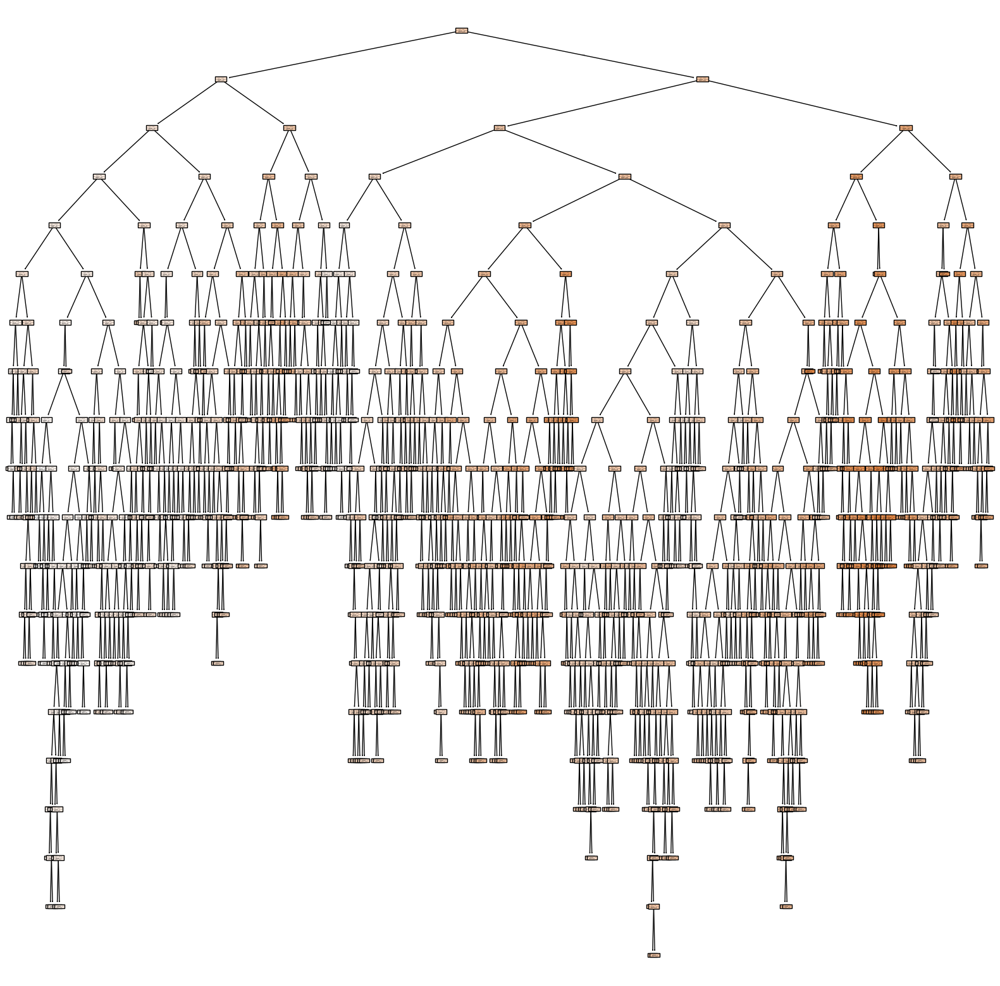

In [86]:
plt.figure(figsize=(20,20))
tree.plot_tree(dt_model,filled=True)

### predict the model

In [102]:
sample = pd.DataFrame([[540, 0, 0, 162, 2, 1040, 676, 28]],
                      columns=x_train.columns)  

predicted_strength = dt_model.predict(sample)
print("Predicted Concrete Compressive Strength (MPa):", predicted_strength)

Predicted Concrete Compressive Strength (MPa): [57.23]


## In the above model node does'nt show clearly so used to less amount of data to show the nodes clearly

In [154]:
df2=df.head(10)

In [156]:
x1=df2.drop(columns='concrete_compressive_strength')

In [158]:
y1=df2.concrete_compressive_strength

In [160]:
x1,y1

(   cement  blast_furnace_slag  fly_ash  water  superplasticizer  \
 0   540.0                22.0    121.4  162.0               2.5   
 1   540.0                22.0    121.4  162.0               2.5   
 2   332.5               142.5    121.4  228.0               6.4   
 3   332.5               142.5    121.4  228.0               6.4   
 4   198.6               132.4    121.4  192.0               6.4   
 5   266.0               114.0    121.4  228.0               6.4   
 6   380.0                95.0    121.4  228.0               6.4   
 7   380.0                95.0    121.4  228.0               6.4   
 8   266.0               114.0    121.4  228.0               6.4   
 9   475.0                22.0    121.4  228.0               6.4   
 
    coarse_aggregate  fine_aggregate   age  
 0            1040.0            676.0   28  
 1            1055.0            676.0   28  
 2             932.0            594.0  270  
 3             932.0            594.0  365  
 4             978.4     

### Build the model on this data x1 and y1

In [163]:
dt_model_1=DecisionTreeRegressor()

In [165]:
dt_model_1.fit(x1,y1)

,criterion,'squared_error'
,splitter,'best'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,None
,random_state,None
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,ccp_alpha,0.0


[Text(0.36538461538461536, 0.9166666666666666, 'x[3] <= 177.0\nsquared_error = 157.135\nsamples = 10\nvalue = 47.982'),
 Text(0.15384615384615385, 0.75, 'x[5] <= 1047.5\nsquared_error = 81.903\nsamples = 2\nvalue = 70.94'),
 Text(0.2596153846153846, 0.8333333333333333, 'True  '),
 Text(0.07692307692307693, 0.5833333333333334, 'squared_error = 0.0\nsamples = 1\nvalue = 79.99'),
 Text(0.23076923076923078, 0.5833333333333334, 'squared_error = 0.0\nsamples = 1\nvalue = 61.89'),
 Text(0.5769230769230769, 0.75, 'x[6] <= 632.0\nsquared_error = 11.234\nsamples = 8\nvalue = 42.243'),
 Text(0.47115384615384615, 0.8333333333333333, '  False'),
 Text(0.38461538461538464, 0.5833333333333334, 'x[7] <= 149.0\nsquared_error = 5.571\nsamples = 5\nvalue = 40.152'),
 Text(0.23076923076923078, 0.4166666666666667, 'x[0] <= 427.5\nsquared_error = 2.016\nsamples = 2\nvalue = 37.87'),
 Text(0.15384615384615385, 0.25, 'squared_error = 0.0\nsamples = 1\nvalue = 36.45'),
 Text(0.3076923076923077, 0.25, 'squared_

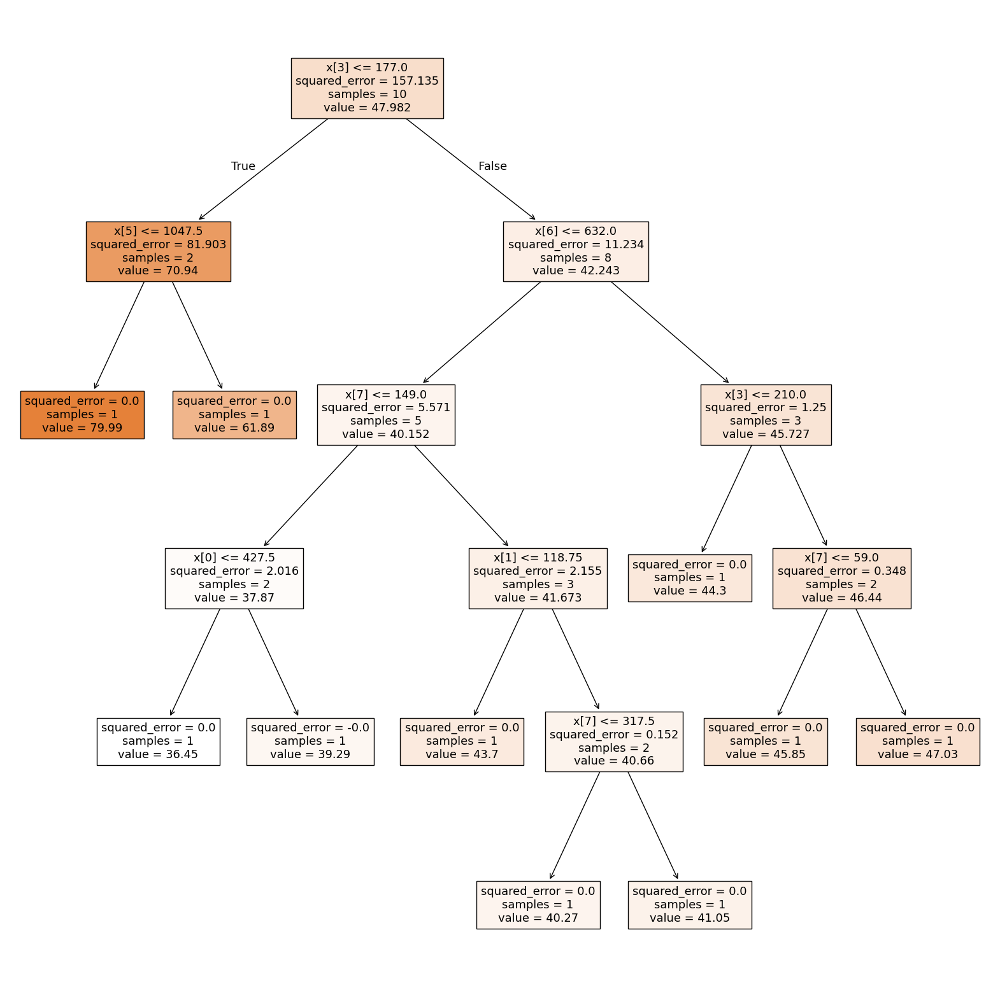

In [167]:
plt.figure(figsize=(20,20))
tree.plot_tree(dt_model_1,filled=True)

### Above show the tree node clearly

# Imporove the model in training and testing (dt_model)

### Because the model is overfitted

In [178]:
param_grid = {
    'criterion': ['squared_error', 'friedman_mse'],
    'max_depth': [5, 7, 10, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt'],
    'ccp_alpha': [0.0, 0.001, 0.005, 0.01]  # pruning
}


In [180]:
grid_search = GridSearchCV(estimator=dt_model,
    param_grid=param_grid,
    cv=3,            
    scoring='r2',
    n_jobs=-1,             
    verbose=1
)

In [182]:
grid_search.fit(x_train,y_train)

Fitting 3 folds for each of 144 candidates, totalling 432 fits


,estimator,DecisionTreeRegressor()
,param_grid,"{'criterion': ['squared_error', 'friedman_mse'], 'max_depth': [5, 7, ...], 'max_features': [None, 'sqrt'], 'min_samples_leaf': [1, 2, ...], ...}"
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,3
,verbose,1
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,criterion,'squared_error'


In [184]:
grid_search.best_params_

{'criterion': 'squared_error',
 'max_depth': 10,
 'max_features': None,
 'min_samples_leaf': 1,
 'min_samples_split': 5}

## Based on this paramert Build the model

In [188]:
Final_model=DecisionTreeRegressor(max_depth=10,min_samples_split=5)

In [190]:
Final_model.fit(x_train,y_train)

,criterion,'squared_error'
,splitter,'best'
,max_depth,10
,min_samples_split,5
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,None
,random_state,None
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,ccp_alpha,0.0


## plot the tree

[Text(0.36538461538461536, 0.9166666666666666, 'x[3] <= 177.0\nsquared_error = 157.135\nsamples = 10\nvalue = 47.982'),
 Text(0.15384615384615385, 0.75, 'x[5] <= 1047.5\nsquared_error = 81.903\nsamples = 2\nvalue = 70.94'),
 Text(0.2596153846153846, 0.8333333333333333, 'True  '),
 Text(0.07692307692307693, 0.5833333333333334, 'squared_error = 0.0\nsamples = 1\nvalue = 79.99'),
 Text(0.23076923076923078, 0.5833333333333334, 'squared_error = 0.0\nsamples = 1\nvalue = 61.89'),
 Text(0.5769230769230769, 0.75, 'x[6] <= 632.0\nsquared_error = 11.234\nsamples = 8\nvalue = 42.243'),
 Text(0.47115384615384615, 0.8333333333333333, '  False'),
 Text(0.38461538461538464, 0.5833333333333334, 'x[7] <= 149.0\nsquared_error = 5.571\nsamples = 5\nvalue = 40.152'),
 Text(0.23076923076923078, 0.4166666666666667, 'x[0] <= 427.5\nsquared_error = 2.016\nsamples = 2\nvalue = 37.87'),
 Text(0.15384615384615385, 0.25, 'squared_error = 0.0\nsamples = 1\nvalue = 36.45'),
 Text(0.3076923076923077, 0.25, 'squared_

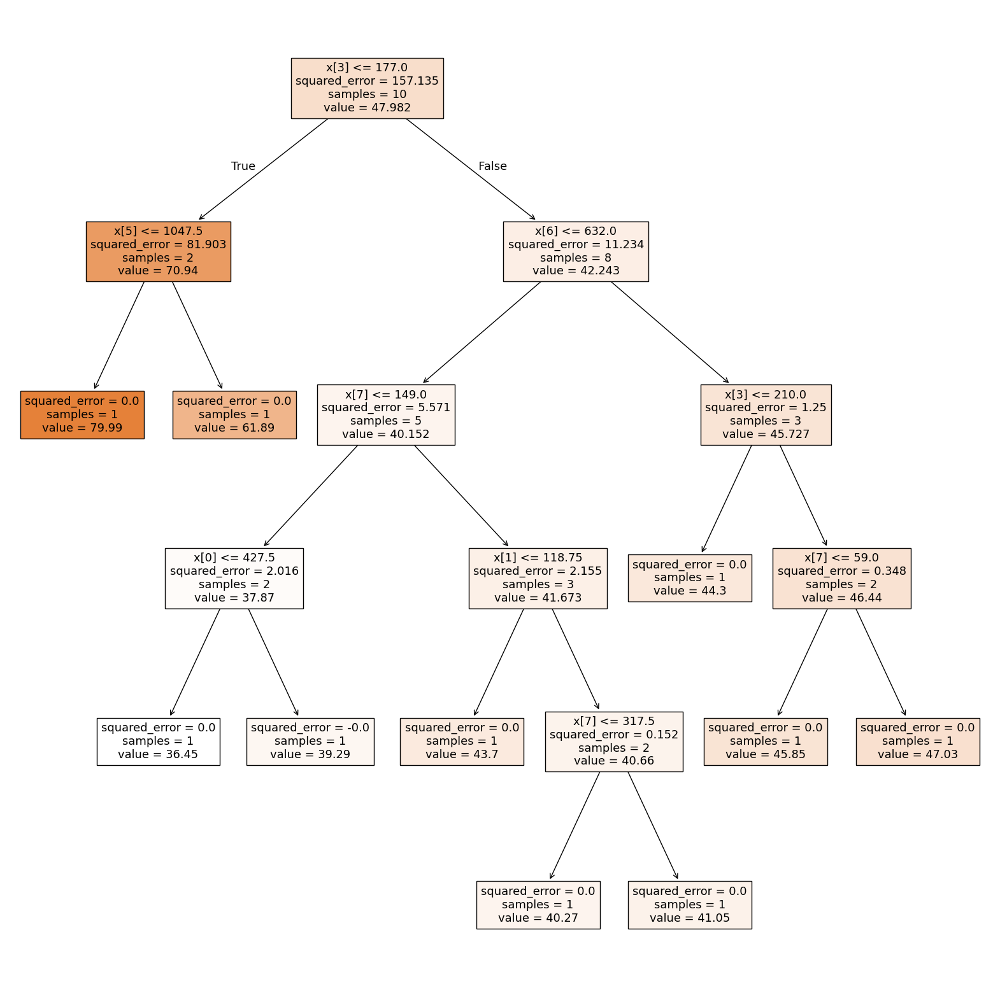

In [194]:
plt.figure(figsize=(20,20))
tree.plot_tree(dt_model_1,filled=True)

### Predict the model

In [200]:
sample = pd.DataFrame([[540, 0, 0, 162, 2, 1040, 676, 28]],
                      columns=x_train.columns)

pred_strength = Final_model.predict(sample)
print("Predicted Concrete Compressive Strength (MPa):", pred_strength[0])

Predicted Concrete Compressive Strength (MPa): 55.31


## Evaluate Model (R2, Adjusted R2, MAE, MSE, RMSE)

In [210]:
y_pred = Final_model.predict(x_test)

print("R²:", r2_score(y_test, y_pred))
print("Adjusted R²:", 1 - (1 - r2_score(y_test, y_pred)) * (len(y_test)-1) / (len(y_test)-x_test.shape[1]-1))
print("MAE:", mean_absolute_error(y_test, y_pred))
print("RMSE:", np.sqrt(mean_squared_error(y_test, y_pred)))

R²: 0.8150377192879826
Adjusted R²: 0.8073309575916485
MAE: 5.155167092976559
RMSE: 7.428246898117543


## 🔹  Feature Importance (Tiny Code)

In [215]:
feat_imp = pd.DataFrame({
    "Feature": x_train.columns,
    "Importance": Final_model.feature_importances_
}).sort_values(by="Importance", ascending=False)

print(feat_imp)

              Feature  Importance
0              cement    0.363033
7                 age    0.324798
3               water    0.106858
1  blast_furnace_slag    0.099709
4    superplasticizer    0.032562
6     fine_aggregate     0.029392
5    coarse_aggregate    0.024971
2             fly_ash    0.018678


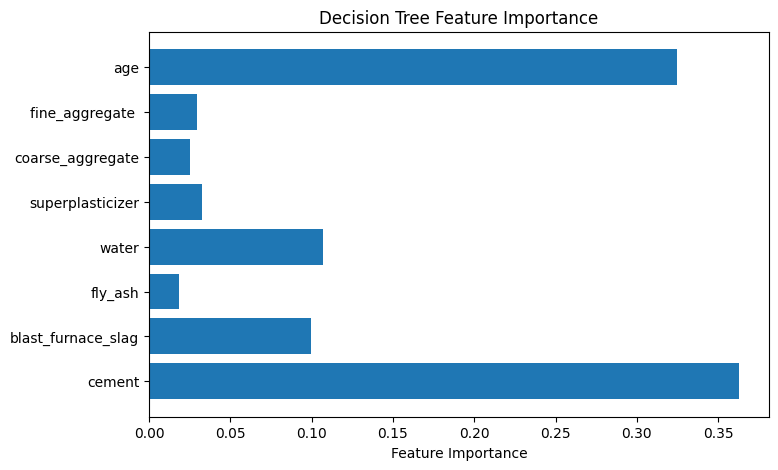

In [221]:
import matplotlib.pyplot as plt

importances = Final_model.feature_importances_
feat_names = x_train.columns

plt.figure(figsize=(8,5))
plt.barh(feat_names, importances)
plt.xlabel("Feature Importance")
plt.title("Decision Tree Feature Importance")
plt.show()

## Residual Plot (Actual vs Residual)

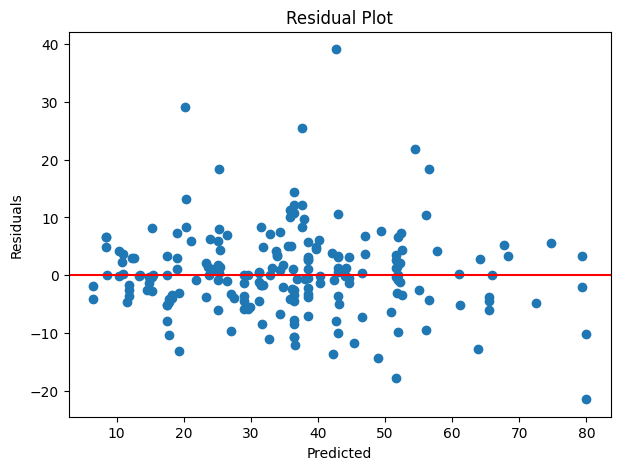

In [224]:
residuals = y_test - y_pred
plt.figure(figsize=(7,5))
plt.scatter(y_pred, residuals)
plt.axhline(0, color='red')
plt.xlabel("Predicted")
plt.ylabel("Residuals")
plt.title("Residual Plot")
plt.show()

##  Prediction Error Plot (Actual vs Predicted)

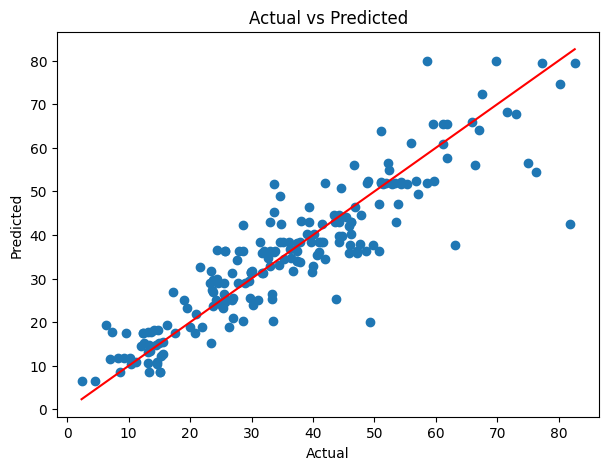

In [228]:
plt.figure(figsize=(7,5))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()],
         [y_test.min(), y_test.max()], 
         color='red')
plt.xlabel("Actual")
plt.ylabel("Predicted")
plt.title("Actual vs Predicted")
plt.show()


### Learning Curve (Underfitting/Overfitting Check)

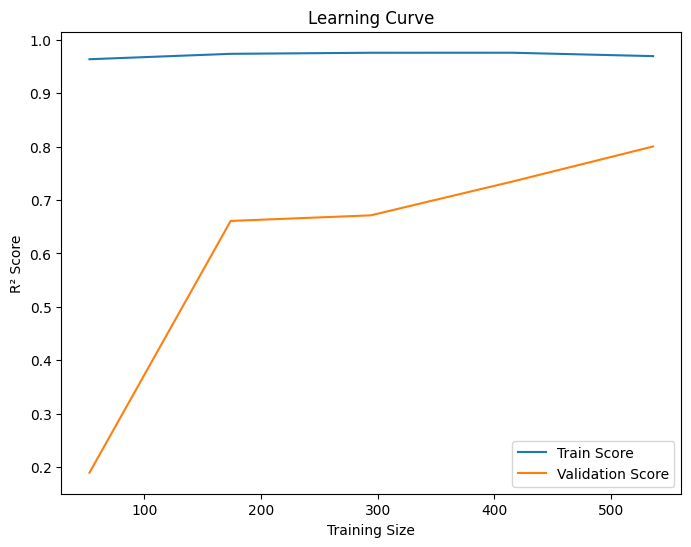

In [231]:
from sklearn.model_selection import learning_curve

train_sizes, train_scores, test_scores = learning_curve(
    Final_model, x_train, y_train, cv=3, n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 5)
)

train_mean = train_scores.mean(axis=1)
test_mean  = test_scores.mean(axis=1)

plt.figure(figsize=(8,6))
plt.plot(train_sizes, train_mean, label="Train Score")
plt.plot(train_sizes, test_mean, label="Validation Score")
plt.xlabel("Training Size")
plt.ylabel("R² Score")
plt.title("Learning Curve")
plt.legend()
plt.show()

##  Validation Curve for Max Depth (Hyperparameter Effect)

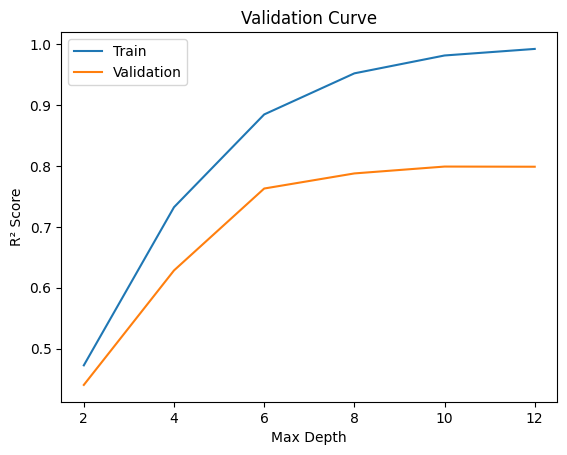

In [236]:
from sklearn.model_selection import validation_curve

param_range = [2, 4, 6, 8, 10, 12]

train_scores, test_scores = validation_curve(
    DecisionTreeRegressor(),
    x_train, y_train,
    param_name="max_depth",
    param_range=param_range,
    scoring="r2",
    cv=3
)

plt.plot(param_range, train_scores.mean(axis=1), label="Train")
plt.plot(param_range, test_scores.mean(axis=1), label="Validation")
plt.xlabel("Max Depth")
plt.ylabel("R² Score")
plt.title("Validation Curve")
plt.legend()
plt.show()

In [240]:
print("Best CV Score:", grid_search.best_score_)

Best CV Score: 0.8059798674443703


In [ ]:
import joblib

# Save the model
joblib.dump(Final_model, "decision_tree_model.pkl")
print("model s")